# Importations

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
!pip install rfdetr

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.0/44.0 kB 5.2 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of torchvision to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 163.2/163.2 kB 11.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.9/887.9 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 322.4/322.4 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.6/155.6 MB 15.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.6/8.6 MB 153.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.0/12.0 MB 149.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.8/91.8 kB 12.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 8.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 48.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 217.4/217.4 

In [5]:
!git clone --depth 1 -b develop https://github.com/roboflow/rf-detr.git
!cd rf-detr

Cloning into 'rf-detr'...
remote: Enumerating objects: 173, done.
remote: Counting objects: 100% (173/173), done.
remote: Compressing objects: 100% (154/154), done.
remote: Total 173 (delta 20), reused 64 (delta 10), pack-reused 0 (from 0)
Receiving objects: 100% (173/173), 242.38 KiB | 1.89 MiB/s, done.
Resolving deltas: 100% (20/20), done.


# Utilisation de RF-DETR sur roboflow

## Importation du dataset et entrainement

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="ROBOFLOW_API_KEY")
project = rf.workspace("crueyzeraphal").project("fox-vs-gallinaceous")
version = project.version(2)
dataset = version.download("coco")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to fox-VS-gallinaceous-2 in coco:: 100%|██████████| 1048/1048 [00:00<00:00, 3589.16it/s]


In [9]:
from rfdetr import RFDETRNano

model = RFDETRNano()
history = []

def callback2(data):
	history.append(data)

model.callbacks["on_fit_epoch_end"].append(callback2)

model.train(dataset_dir=dataset.location, epochs=10, batch_size=32, lr=1e-4)

[2026-02-16 10:39:59] [INFO] rf-detr - Downloading pretrained weights for rf-detr-nano.pth


rf-detr-nano.pth: 100%|██████████| 349M/349M [00:04<00:00, 90.1MiB/s]
[2026-02-16 10:40:03] [WARNING] rf-detr - Using a different number of positional encodings than DINOv2, which means we're not loading DINOv2 backbone weights. This is not a problem if finetuning a pretrained RF-DETR model.
[2026-02-16 10:40:03] [WARNING] rf-detr - Using patch size 16 instead of 14, which means we're not loading DINOv2 backbone weights. This is not a problem if finetuning a pretrained RF-DETR model.


[2026-02-16 10:40:03] [INFO] rf-detr - Loading pretrain weights


[2026-02-16 10:40:04] [WARNING] rf-detr - Reinitializing your detection head with 3 classes.


[2026-02-16 10:40:04] [INFO] rf-detr - TensorBoard logging initialized. To monitor logs, use 'tensorboard --logdir output' and open http://localhost:6006/ in browser.
[2026-02-16 10:40:04] [INFO] rf-detr - Not using distributed mode
[2026-02-16 10:40:04] [INFO] rf-detr - git:
  unknown

[2026-02-16 10:40:04] [INFO] rf-detr - Namespace(num_classes=3, grad_accum_steps=4, print_freq=10, amp=True, lr=0.0001, lr_encoder=0.00015, batch_size=32, weight_decay=0.0001, epochs=10, lr_drop=100, clip_max_norm=0.1, lr_vit_layer_decay=0.8, lr_component_decay=0.7, do_benchmark=False, dropout=0, drop_path=0.0, drop_mode='standard', drop_schedule='constant', cutoff_epoch=0, pretrained_encoder=None, pretrain_weights='rf-detr-nano.pth', pretrain_exclude_keys=None, pretrain_keys_modify_to_load=None, pretrained_distiller=None, encoder='dinov2_windowed_small', vit_encoder_num_layers=12, window_block_indexes=None, position_embedding='sine', out_feature_indexes=[3, 6, 9, 12], freeze_encoder=False, layer_norm=T

[2026-02-16 10:40:13] [INFO] rf-detr - Epoch: [0]  [0/5]  eta: 0:00:45  lr: 0.000100  class_error: 27.87  loss: 6.6236 (6.6236)  loss_ce: 0.9826 (0.9826)  loss_bbox: 0.3603 (0.3603)  loss_giou: 0.8609 (0.8609)  loss_ce_0: 0.9796 (0.9796)  loss_bbox_0: 0.3672 (0.3672)  loss_giou_0: 0.8591 (0.8591)  loss_ce_enc: 0.9785 (0.9785)  loss_bbox_enc: 0.3691 (0.3691)  loss_giou_enc: 0.8664 (0.8664)  loss_ce_unscaled: 0.9826 (0.9826)  class_error_unscaled: 27.8743 (27.8743)  loss_bbox_unscaled: 0.0721 (0.0721)  loss_giou_unscaled: 0.4305 (0.4305)  cardinality_error_unscaled: 3459.9688 (3459.9688)  loss_ce_0_unscaled: 0.9796 (0.9796)  loss_bbox_0_unscaled: 0.0734 (0.0734)  loss_giou_0_unscaled: 0.4296 (0.4296)  cardinality_error_0_unscaled: 3397.9375 (3397.9375)  loss_ce_enc_unscaled: 0.9785 (0.9785)  loss_bbox_enc_unscaled: 0.0738 (0.0738)  loss_giou_enc_unscaled: 0.4332 (0.4332)  cardinality_error_enc_unscaled: 3601.7188 (3601.7188)  time: 9.1888  data: 4.6062  max mem: 12568
[2026-02-16 10:40:2

[2026-02-16 10:40:39] [INFO] rf-detr - Test:  [0/7]  eta: 0:00:11  class_error: 23.58  loss: 5.4581 (5.4581)  loss_ce: 0.9180 (0.9180)  loss_bbox: 0.2459 (0.2459)  loss_giou: 0.6278 (0.6278)  loss_ce_0: 0.9453 (0.9453)  loss_bbox_0: 0.2424 (0.2424)  loss_giou_0: 0.6121 (0.6121)  loss_ce_enc: 0.9023 (0.9023)  loss_bbox_enc: 0.2933 (0.2933)  loss_giou_enc: 0.6709 (0.6709)  loss_ce_unscaled: 0.9180 (0.9180)  class_error_unscaled: 23.5849 (23.5849)  loss_bbox_unscaled: 0.0492 (0.0492)  loss_giou_unscaled: 0.3139 (0.3139)  cardinality_error_unscaled: 75.7812 (75.7812)  loss_ce_0_unscaled: 0.9453 (0.9453)  loss_bbox_0_unscaled: 0.0485 (0.0485)  loss_giou_0_unscaled: 0.3061 (0.3061)  cardinality_error_0_unscaled: 99.3750 (99.3750)  loss_ce_enc_unscaled: 0.9023 (0.9023)  loss_bbox_enc_unscaled: 0.0587 (0.0587)  loss_giou_enc_unscaled: 0.3354 (0.3354)  cardinality_error_enc_unscaled: 150.5625 (150.5625)  time: 1.6198  data: 0.9740  max mem: 12568
[2026-02-16 10:40:43] [INFO] rf-detr - Test:  [6

## Courbe de perte

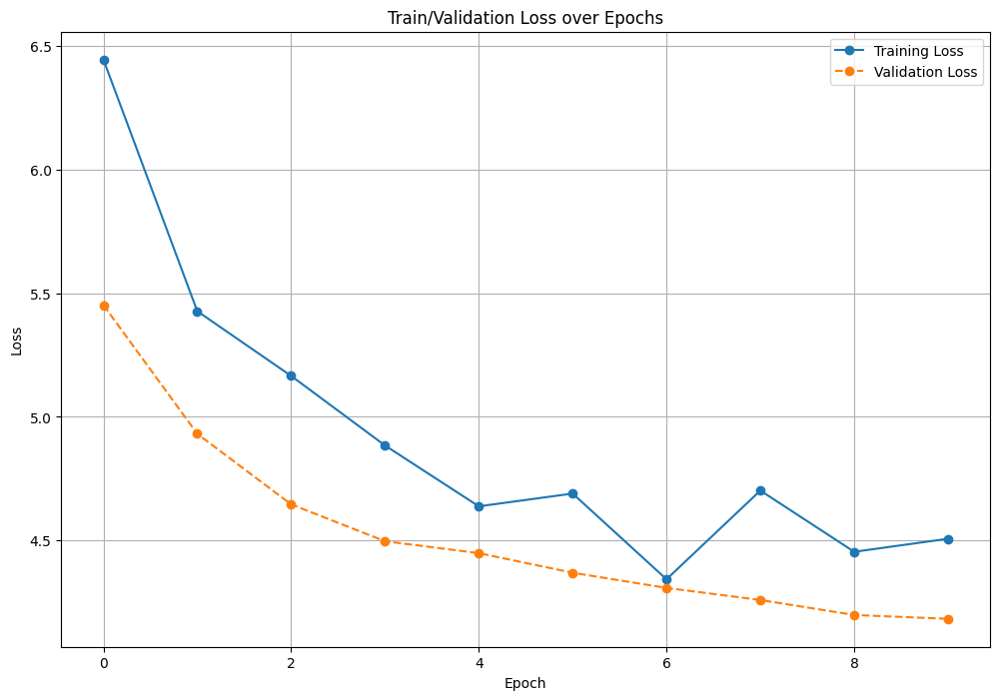

In [10]:
import matplotlib.pyplot as plt
import pandas as pd

df = pd.DataFrame(history)

plt.figure(figsize=(12, 8))

plt.plot(
	df['epoch'],
	df['train_loss'],
	label='Training Loss',
	marker='o',
	linestyle='-'
)

plt.plot(
	df['epoch'],
	df['test_loss'],
	label='Validation Loss',
	marker='o',
	linestyle='--'
)

plt.title('Train/Validation Loss over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.show()

## Test sur des données hors dataset

In [15]:
!pip install supervision opencv-python

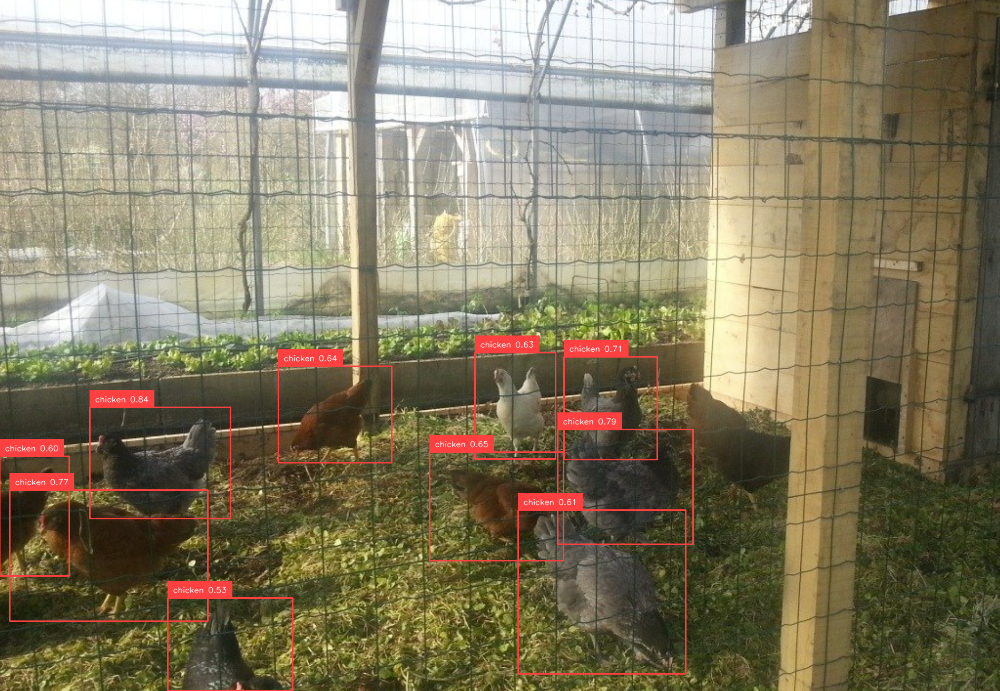

In [21]:
import cv2
import supervision as sv
import json
from google.colab.patches import cv2_imshow

# Charger classes
annotation_path = f"{dataset.location}/valid/_annotations.coco.json"
with open(annotation_path) as f:
    coco = json.load(f)

id2label = {cat["id"]: cat["name"] for cat in coco["categories"]}

# Prédiction
image = cv2.imread('/content/Ressources_Images/10t_mp4-0004.jpg', cv2.IMREAD_UNCHANGED)
if image.shape[2] == 4:
    image = cv2.cvtColor(image, cv2.COLOR_BGRA2BGR)
detections = model.predict(image, confidence=0.5)

# Annotateurs
box_annotator = sv.BoxAnnotator()
label_annotator = sv.LabelAnnotator()

labels = [
    f"{id2label[class_id]} {confidence:.2f}"
    for class_id, confidence
    in zip(detections.class_id, detections.confidence)
]

annotated = box_annotator.annotate(scene=image, detections=detections)
annotated = label_annotator.annotate(
    scene=annotated,
    detections=detections,
    labels=labels
)

cv2_imshow(annotated)


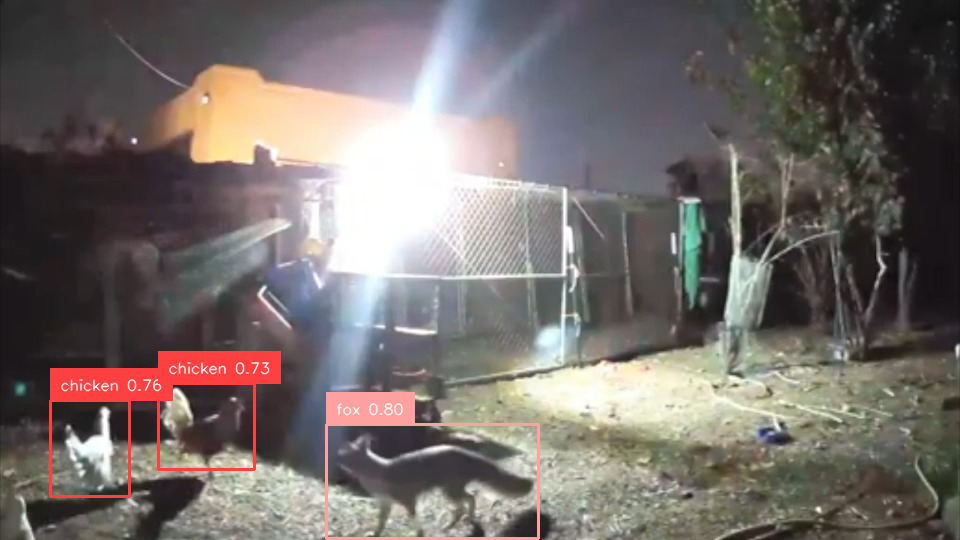

In [22]:
import cv2
import supervision as sv
import json
from google.colab.patches import cv2_imshow

# Charger classes
annotation_path = f"{dataset.location}/valid/_annotations.coco.json"
with open(annotation_path) as f:
    coco = json.load(f)

id2label = {cat["id"]: cat["name"] for cat in coco["categories"]}

# Prédiction
image = cv2.imread('/content/Ressources_Images/10t_mp4-0004.jpg', cv2.IMREAD_UNCHANGED)
if image.shape[2] == 4:
    image = cv2.cvtColor(image, cv2.COLOR_BGRA2BGR)
detections = model.predict(image, confidence=0.5)

# Annotateurs
box_annotator = sv.BoxAnnotator()
label_annotator = sv.LabelAnnotator()

labels = [
    f"{id2label[class_id]} {confidence:.2f}"
    for class_id, confidence
    in zip(detections.class_id, detections.confidence)
]

annotated = box_annotator.annotate(scene=image, detections=detections)
annotated = label_annotator.annotate(
    scene=annotated,
    detections=detections,
    labels=labels
)

cv2_imshow(annotated)


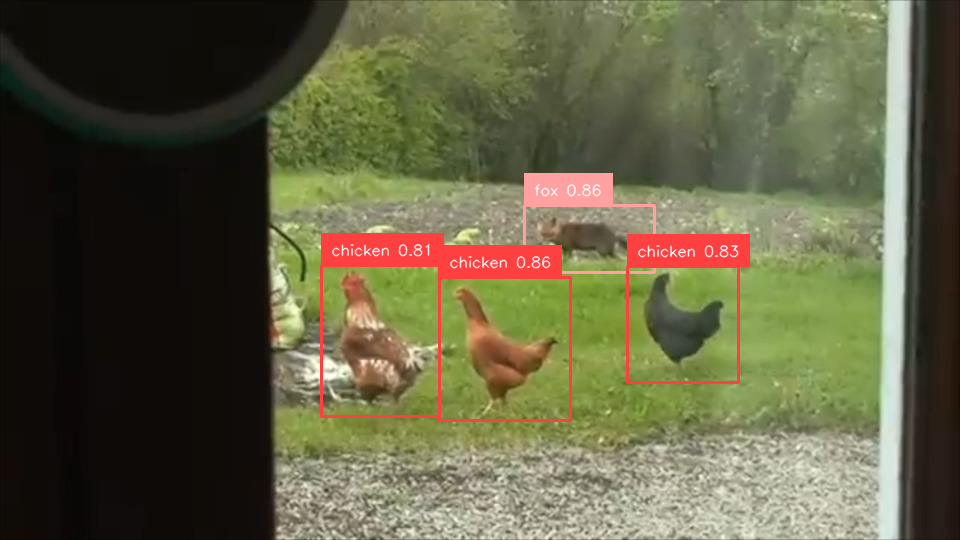

In [23]:
import cv2
import supervision as sv
import json
from google.colab.patches import cv2_imshow

# Charger classes
annotation_path = f"{dataset.location}/valid/_annotations.coco.json"
with open(annotation_path) as f:
    coco = json.load(f)

id2label = {cat["id"]: cat["name"] for cat in coco["categories"]}

# Prédiction
image = cv2.imread('/content/Ressources_Images/12t_mp4-0046.jpg', cv2.IMREAD_UNCHANGED)
if image.shape[2] == 4:
    image = cv2.cvtColor(image, cv2.COLOR_BGRA2BGR)
detections = model.predict(image, confidence=0.5)

# Annotateurs
box_annotator = sv.BoxAnnotator()
label_annotator = sv.LabelAnnotator()

labels = [
    f"{id2label[class_id]} {confidence:.2f}"
    for class_id, confidence
    in zip(detections.class_id, detections.confidence)
]

annotated = box_annotator.annotate(scene=image, detections=detections)
annotated = label_annotator.annotate(
    scene=annotated,
    detections=detections,
    labels=labels
)

cv2_imshow(annotated)


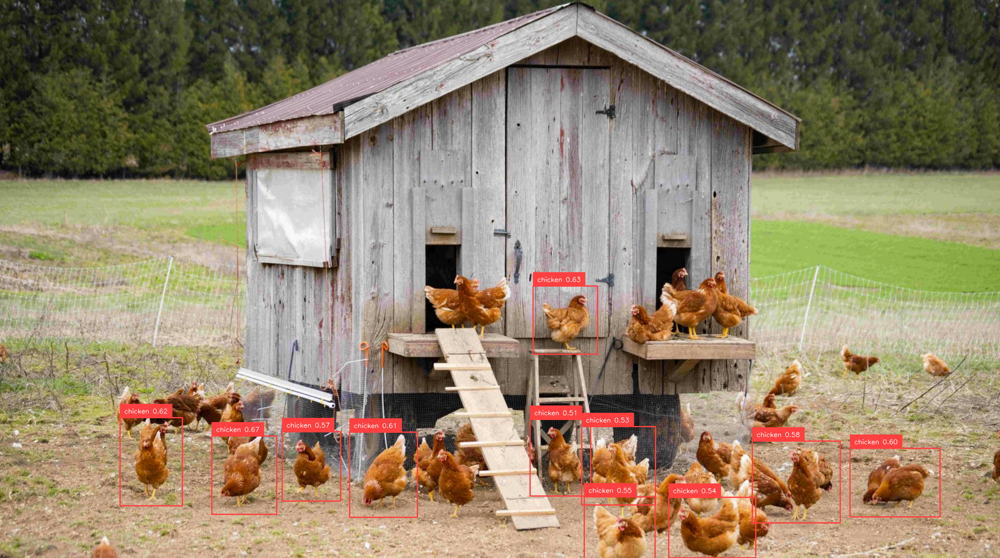

In [24]:
import cv2
import supervision as sv
import json
from google.colab.patches import cv2_imshow

# Charger classes
annotation_path = f"{dataset.location}/valid/_annotations.coco.json"
with open(annotation_path) as f:
    coco = json.load(f)

id2label = {cat["id"]: cat["name"] for cat in coco["categories"]}

# Prédiction
image = cv2.imread('/content/Ressources_Images/Poules_Nombreuses.png', cv2.IMREAD_UNCHANGED)
if image.shape[2] == 4:
    image = cv2.cvtColor(image, cv2.COLOR_BGRA2BGR)
detections = model.predict(image, confidence=0.5)

# Annotateurs
box_annotator = sv.BoxAnnotator()
label_annotator = sv.LabelAnnotator()

labels = [
    f"{id2label[class_id]} {confidence:.2f}"
    for class_id, confidence
    in zip(detections.class_id, detections.confidence)
]

annotated = box_annotator.annotate(scene=image, detections=detections)
annotated = label_annotator.annotate(
    scene=annotated,
    detections=detections,
    labels=labels
)

cv2_imshow(annotated)


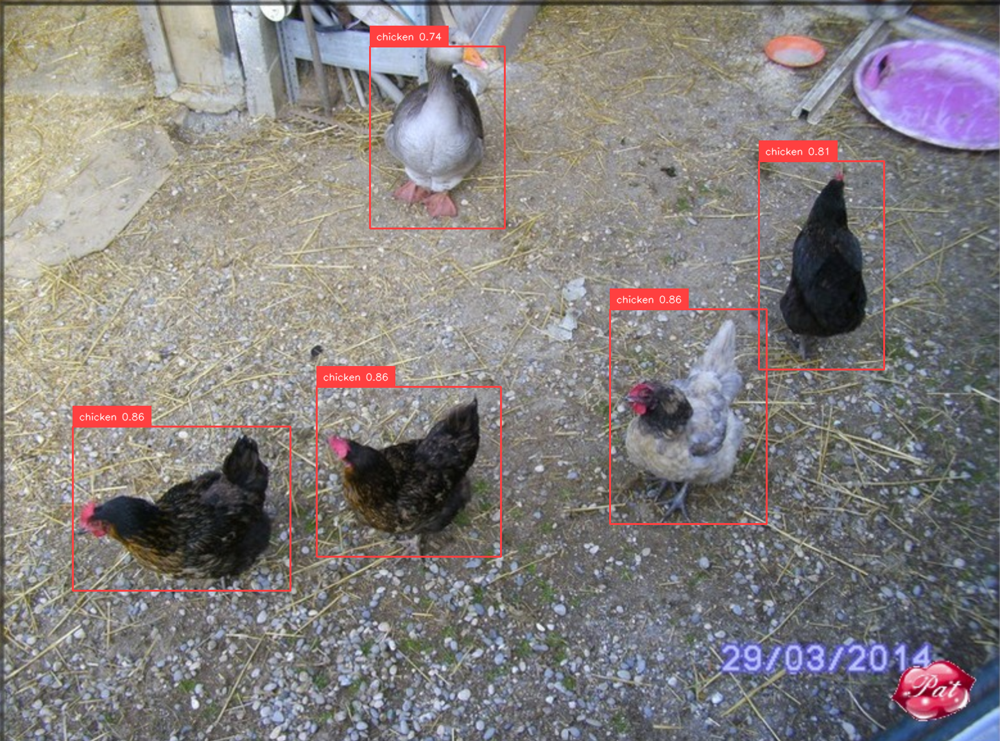

In [25]:
import cv2
import supervision as sv
import json
from google.colab.patches import cv2_imshow

# Charger classes
annotation_path = f"{dataset.location}/valid/_annotations.coco.json"
with open(annotation_path) as f:
    coco = json.load(f)

id2label = {cat["id"]: cat["name"] for cat in coco["categories"]}

# Prédiction
image = cv2.imread('/content/Ressources_Images/Poules_Oies.png', cv2.IMREAD_UNCHANGED)
if image.shape[2] == 4:
    image = cv2.cvtColor(image, cv2.COLOR_BGRA2BGR)
detections = model.predict(image, confidence=0.5)

# Annotateurs
box_annotator = sv.BoxAnnotator()
label_annotator = sv.LabelAnnotator()

labels = [
    f"{id2label[class_id]} {confidence:.2f}"
    for class_id, confidence
    in zip(detections.class_id, detections.confidence)
]

annotated = box_annotator.annotate(scene=image, detections=detections)
annotated = label_annotator.annotate(
    scene=annotated,
    detections=detections,
    labels=labels
)

cv2_imshow(annotated)


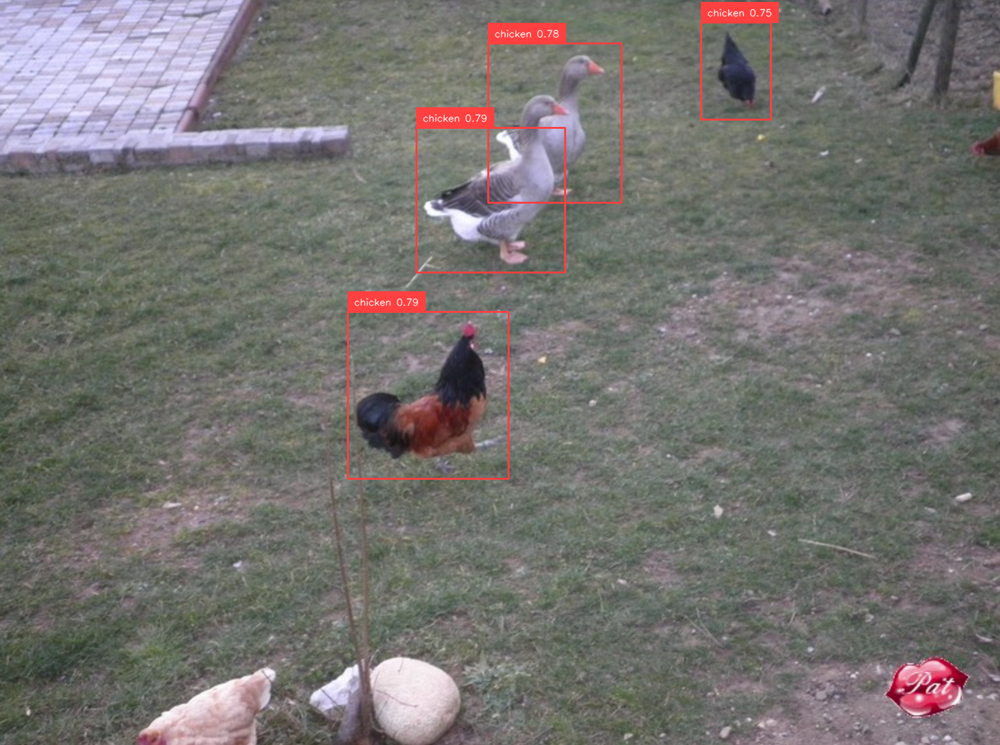

In [26]:
import cv2
import supervision as sv
import json
from google.colab.patches import cv2_imshow

# Charger classes
annotation_path = f"{dataset.location}/valid/_annotations.coco.json"
with open(annotation_path) as f:
    coco = json.load(f)

id2label = {cat["id"]: cat["name"] for cat in coco["categories"]}

# Prédiction
image = cv2.imread('/content/Ressources_Images/Poules_Oies_2.png', cv2.IMREAD_UNCHANGED)
if image.shape[2] == 4:
    image = cv2.cvtColor(image, cv2.COLOR_BGRA2BGR)
detections = model.predict(image, confidence=0.5)

# Annotateurs
box_annotator = sv.BoxAnnotator()
label_annotator = sv.LabelAnnotator()

labels = [
    f"{id2label[class_id]} {confidence:.2f}"
    for class_id, confidence
    in zip(detections.class_id, detections.confidence)
]

annotated = box_annotator.annotate(scene=image, detections=detections)
annotated = label_annotator.annotate(
    scene=annotated,
    detections=detections,
    labels=labels
)

cv2_imshow(annotated)
